# CISC 873 Data Mining Competition 2 (Speed Dating Match Prediction)

## Questions

### Why a simple linear regression model (without any activation function) is not good for classification task, compared to Perceptron/Logistic regression?

- Linear regression model without the activation function will not be able to transform continuous values to discrete values for classification tasks like 0 and 1.

- Perceptron and logistic regression models can be used for classification tasks because the activation function can transform the continuous output of the linear model to a binary output, the activation function convert the continuous values to 0 and 1.

### What's a decision tree and how it is different to a logistic regression model?

- Decision tree is a machine learning model that is used for both classification and regression tasks.

- Decision tree and Logistic regression are are used for different types of tasks.
    - Decision tree is a non-parametric model that is used for both classification and regression tasks.
    - Logistic regression is a parametric model that is used for binary classification tasks.

### What's the difference between grid search and random search?

- Grid search and random search are two common methods for hyperparameter tuning in machine learning.
    - Grid search involves specifying a grid of hyperparameters and exhaustively searching over all possible combinations of hyperparameters within the grid.
    - Random search involves randomly sampling hyperparameters from a predefined distribution, it trains and evaluates a model for each sample.


### What's the difference between bayesian search and random search?

- Bayesian optimization and random search are two methods used for hyperparameter tuning in machine learning.
    - Random search involves randomly sampling hyperparameters from a predefined distribution, it train and evaluates a model for each sample.
    - Bayesian optimization, on the other hand, uses a probabilistic model to guide the search for optimal hyperparameters.

## Overview

### Define the problem

Predict the outcome of a specific speed dating session based on the profile of two people, so we can implement a recommendation system to better match people in speed dating events.

### What is the input?

We did have online dating dataset (Tinder-like)
- The data consists of 190 feature columns except the 'ID' column and the target column

### What is the output?

The probability (0-1, float) that the dating session will lead to a successful match.
- The target column is 'match'

### What data mining function is required?

Binary Classification

### What could be the challenges?

- The dataset has many missing value.
- The dataset is imbalanced
- Find the best model
- Find the best hyperparameters of this model
- Find the best search method for these hyperparameters

## Data Preprocessing

### Import Libiraries

In [1]:
import numpy as np
import pandas as pd
import re
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline

# set rundom seed
seed = 72
np.random.seed(seed)

###  Read data

In [2]:
# reading training and testing files
# put files in the same directory with this notebook
df = pd.read_csv('train.csv')
df_test = pd.read_csv('test.csv')

### Check data balance

<AxesSubplot:>

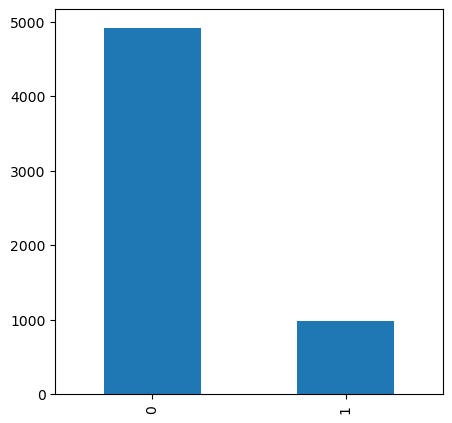

In [3]:
# plot column match which is the target column to see the classes balance
plt.rcParams["figure.figsize"] = (5, 5)
df.match.value_counts().plot(kind='bar')

### Analyis the dataset

In [4]:
# checking columns info ex: data type of each column
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5909 entries, 0 to 5908
Columns: 192 entries, gender to id
dtypes: float64(173), int64(11), object(8)
memory usage: 8.7+ MB


In [5]:
# check some statistics about the data
df.describe()

,gender,idg,condtn,wave,round,position,positin1,order,partner,pid,...,sinc3_3,intel3_3,fun3_3,amb3_3,attr5_3,sinc5_3,intel5_3,fun5_3,amb5_3,id
count,5909.000000,5909.000000,5909.000000,5909.000000,5909.000000,5909.000000,4591.000000,5909.00000,5909.000000,5901.000000,...,2804.000000,2804.000000,2804.000000,2804.000000,1413.000000,1413.000000,1413.000000,1413.000000,1413.000000,5909.000000
mean,0.505331,17.360298,1.824843,11.347436,16.850228,9.001523,9.254846,8.91166,8.962938,283.733266,...,8.105563,8.377318,7.644437,7.398716,6.799717,7.631989,7.944798,7.162774,7.092711,4191.314943
std,0.500014,10.947542,0.380133,6.011495,4.389246,5.482368,5.611803,5.45710,5.500706,158.993002,...,1.601011,1.459013,1.757559,1.956924,1.535768,1.498024,1.320919,1.687431,1.713729,2408.009173
min,0.000000,1.000000,1.000000,1.000000,5.000000,1.000000,1.000000,1.00000,1.000000,1.000000,...,2.000000,3.000000,2.000000,1.000000,2.000000,2.000000,4.000000,1.000000,1.000000,0.000000
25%,0.000000,8.000000,2.000000,7.000000,14.000000,4.000000,4.000000,4.00000,4.000000,153.000000,...,7.000000,8.000000,7.000000,6.000000,6.000000,7.000000,7.000000,6.000000,6.000000,2124.000000
50%,1.000000,16.000000,2.000000,11.000000,18.000000,8.000000,9.000000,8.00000,8.000000,280.000000,...,8.000000,8.000000,8.000000,8.000000,7.000000,8.000000,8.000000,7.000000,7.000000,4210.000000
75%,1.000000,26.000000,2.000000,15.000000,20.000000,13.000000,14.000000,13.00000,13.000000,409.000000,...,9.000000,9.000000,9.000000,9.000000,8.000000,9.000000,9.000000,8.000000,8.000000,6266.000000
max,1.000000,44.000000,2.000000,21.000000,22.000000,22.000000,22.000000,22.00000,22.000000,552.000000,...,12.000000,12.000000,12.000000,12.000000,10.000000,10.000000,10.000000,10.000000,10.000000,8372.000000


### Data Visiualization

array([[<AxesSubplot:title={'center':'gender'}>,
        <AxesSubplot:title={'center':'idg'}>,
        <AxesSubplot:title={'center':'condtn'}>,
        <AxesSubplot:title={'center':'wave'}>,
        <AxesSubplot:title={'center':'round'}>,
        <AxesSubplot:title={'center':'position'}>,
        <AxesSubplot:title={'center':'positin1'}>,
        <AxesSubplot:title={'center':'order'}>,
        <AxesSubplot:title={'center':'partner'}>,
        <AxesSubplot:title={'center':'pid'}>,
        <AxesSubplot:title={'center':'match'}>,
        <AxesSubplot:title={'center':'int_corr'}>,
        <AxesSubplot:title={'center':'samerace'}>,
        <AxesSubplot:title={'center':'age_o'}>],
       [<AxesSubplot:title={'center':'race_o'}>,
        <AxesSubplot:title={'center':'pf_o_att'}>,
        <AxesSubplot:title={'center':'pf_o_sin'}>,
        <AxesSubplot:title={'center':'pf_o_int'}>,
        <AxesSubplot:title={'center':'pf_o_fun'}>,
        <AxesSubplot:title={'center':'pf_o_amb'}>,
        <Axe

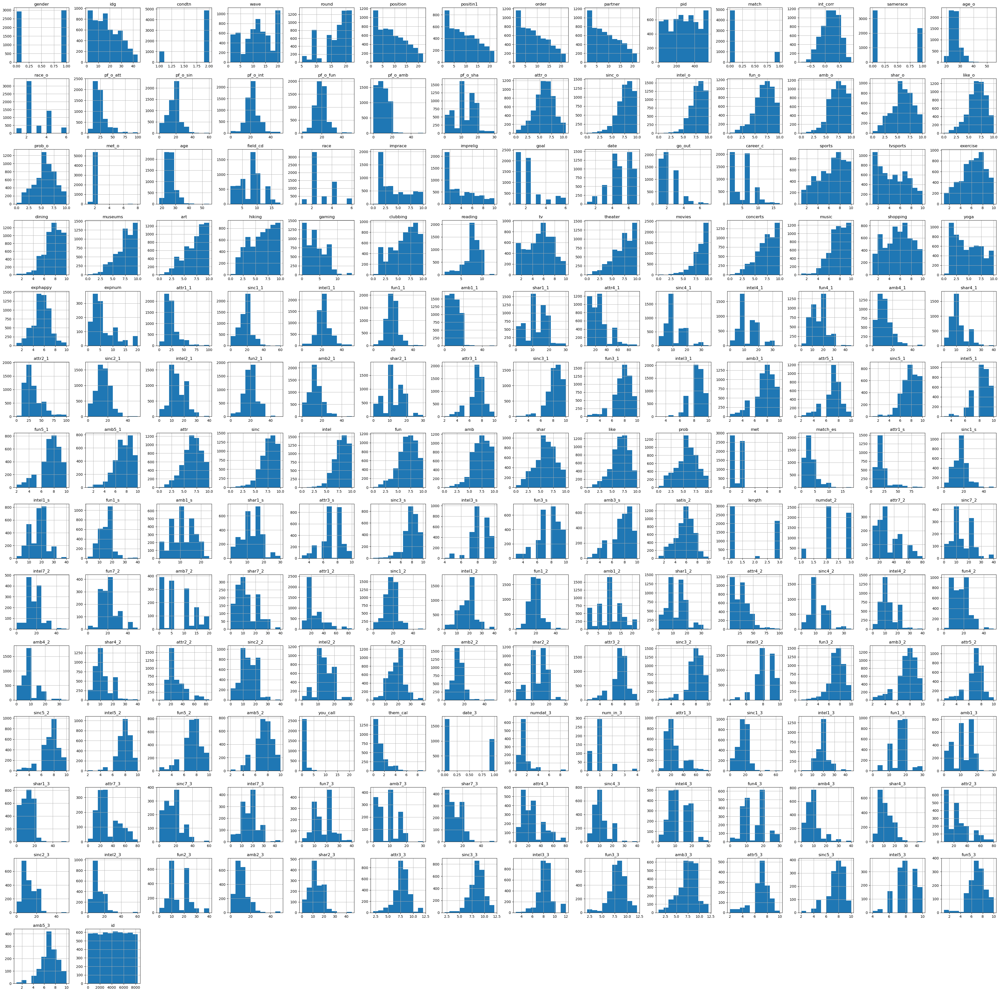

In [6]:
# plot the histogram of each column
plt.rcParams["figure.figsize"] = (50,50)
df.hist()

In [7]:
# I will display correlation again after cleaning for better visualization
plt.figure(figsize = (140, 70))
sns.heatmap(np.round(df._get_numeric_data().corr(), 2), annot = True, cmap="Greens")
plt.show()

### Check Missing

<AxesSubplot:>

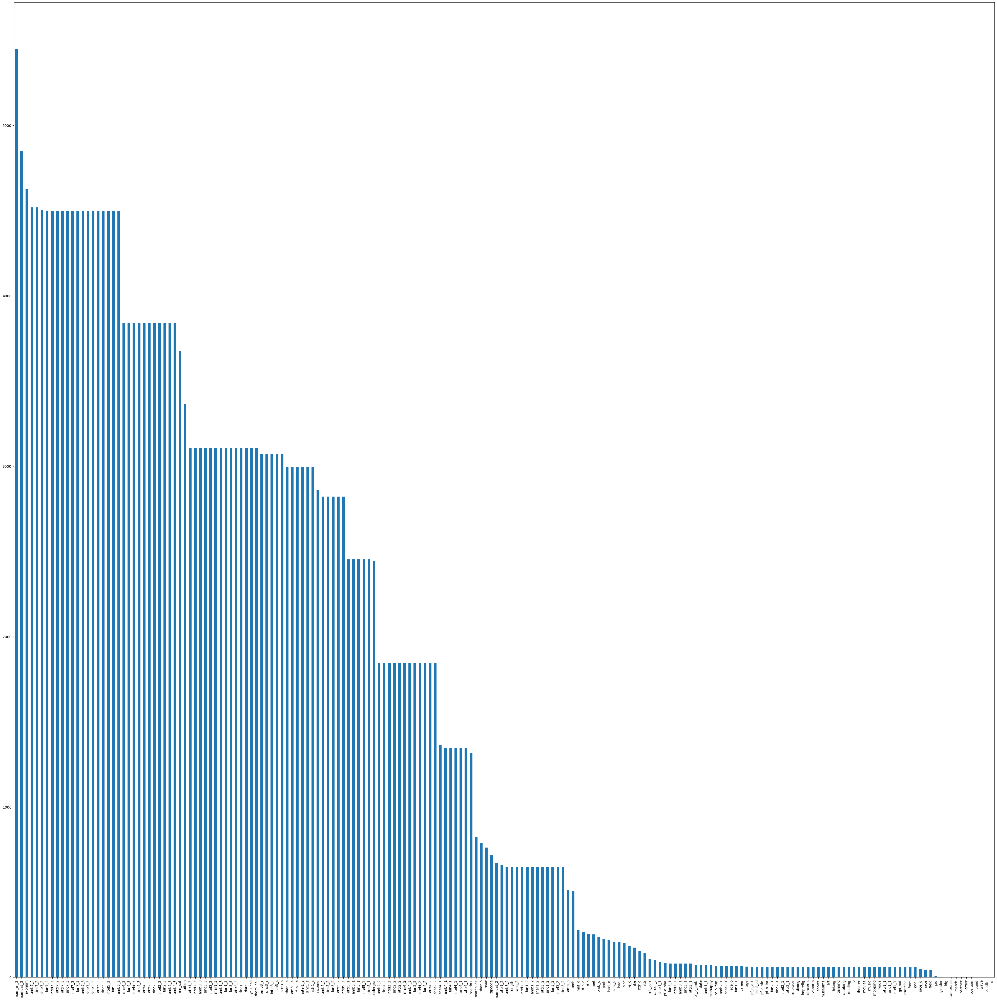

In [8]:
# plot the count of missing values in each column
df.isnull().sum().sort_values(ascending=False).plot(kind='bar')

I decided to remove any columns that has more than 60% of missing value

In [9]:
# make a copy before update the data
# find columns with less than 60 of missing values
columns = df.isnull().sum() < int(df.shape[0] * 0.60)
# find the names of these columns
columns = list(df.columns[columns])
print(columns)

['gender', 'idg', 'condtn', 'wave', 'round', 'position', 'positin1', 'order', 'partner', 'pid', 'match', 'int_corr', 'samerace', 'age_o', 'race_o', 'pf_o_att', 'pf_o_sin', 'pf_o_int', 'pf_o_fun', 'pf_o_amb', 'pf_o_sha', 'attr_o', 'sinc_o', 'intel_o', 'fun_o', 'amb_o', 'shar_o', 'like_o', 'prob_o', 'met_o', 'age', 'field', 'field_cd', 'undergra', 'tuition', 'race', 'imprace', 'imprelig', 'from', 'zipcode', 'income', 'goal', 'date', 'go_out', 'career', 'career_c', 'sports', 'tvsports', 'exercise', 'dining', 'museums', 'art', 'hiking', 'gaming', 'clubbing', 'reading', 'tv', 'theater', 'movies', 'concerts', 'music', 'shopping', 'yoga', 'exphappy', 'attr1_1', 'sinc1_1', 'intel1_1', 'fun1_1', 'amb1_1', 'shar1_1', 'attr4_1', 'sinc4_1', 'intel4_1', 'fun4_1', 'amb4_1', 'shar4_1', 'attr2_1', 'sinc2_1', 'intel2_1', 'fun2_1', 'amb2_1', 'shar2_1', 'attr3_1', 'sinc3_1', 'fun3_1', 'intel3_1', 'amb3_1', 'attr5_1', 'sinc5_1', 'intel5_1', 'fun5_1', 'amb5_1', 'attr', 'sinc', 'intel', 'fun', 'amb', 'shar'

Doing The same thing for test data

In [10]:
# but we remove the target column before applying the same process
test_columns = columns.copy()
test_columns.remove('match')
print(test_columns)

['gender', 'idg', 'condtn', 'wave', 'round', 'position', 'positin1', 'order', 'partner', 'pid', 'int_corr', 'samerace', 'age_o', 'race_o', 'pf_o_att', 'pf_o_sin', 'pf_o_int', 'pf_o_fun', 'pf_o_amb', 'pf_o_sha', 'attr_o', 'sinc_o', 'intel_o', 'fun_o', 'amb_o', 'shar_o', 'like_o', 'prob_o', 'met_o', 'age', 'field', 'field_cd', 'undergra', 'tuition', 'race', 'imprace', 'imprelig', 'from', 'zipcode', 'income', 'goal', 'date', 'go_out', 'career', 'career_c', 'sports', 'tvsports', 'exercise', 'dining', 'museums', 'art', 'hiking', 'gaming', 'clubbing', 'reading', 'tv', 'theater', 'movies', 'concerts', 'music', 'shopping', 'yoga', 'exphappy', 'attr1_1', 'sinc1_1', 'intel1_1', 'fun1_1', 'amb1_1', 'shar1_1', 'attr4_1', 'sinc4_1', 'intel4_1', 'fun4_1', 'amb4_1', 'shar4_1', 'attr2_1', 'sinc2_1', 'intel2_1', 'fun2_1', 'amb2_1', 'shar2_1', 'attr3_1', 'sinc3_1', 'fun3_1', 'intel3_1', 'amb3_1', 'attr5_1', 'sinc5_1', 'intel5_1', 'fun5_1', 'amb5_1', 'attr', 'sinc', 'intel', 'fun', 'amb', 'shar', 'like',

In [11]:
# filter the dataframes training and testing with the remaining columns
df1 = df.copy()
df1 = df1[columns]
df_test = df_test[test_columns]

In [12]:
# removing some useless columns
# df1.drop(columns=['id', 'idg', 'zipcode', 'pid'], inplace=True)
# df_test.drop(columns=['idg', 'zipcode', 'pid'], inplace=True)

# after trail and testing I decide not to remove them, the id is enough
df1.drop(columns=['id'], inplace=True)

### Find Categorical Columns

In [13]:
# get numeric columns
df1._get_numeric_data().columns

Index(['gender', 'idg', 'condtn', 'wave', 'round', 'position', 'positin1',
       'order', 'partner', 'pid',
       ...
       'sinc1_3', 'intel1_3', 'fun1_3', 'amb1_3', 'shar1_3', 'attr3_3',
       'sinc3_3', 'intel3_3', 'fun3_3', 'amb3_3'],
      dtype='object', length=151)

In [14]:
# display all columns to compare
df1.columns

Index(['gender', 'idg', 'condtn', 'wave', 'round', 'position', 'positin1',
       'order', 'partner', 'pid',
       ...
       'sinc1_3', 'intel1_3', 'fun1_3', 'amb1_3', 'shar1_3', 'attr3_3',
       'sinc3_3', 'intel3_3', 'fun3_3', 'amb3_3'],
      dtype='object', length=158)

In [15]:
# remove numric columns from all columns to get the categorical columns
features_categorical = [column for column in df1.columns if column not in df1._get_numeric_data().columns]
features_categorical

['field', 'undergra', 'tuition', 'from', 'zipcode', 'income', 'career']

### Encode Categorical Columns

In [16]:
# lower cases to solve the case sensitive problem
# for ex: New York City <==> new york city
# remove all spcial charachter form the data to solve the problem of repeating words but with extra spcial character
# for ex: WASHINGTON, D.C. <==> Washington DC
# now both of them will be washington dc
def clean_lower(value):
    value = str(value).lower()
    value = re.sub('[^0-9a-zA-Z]+',' ', value)
    value = re.sub('\s+', ' ', value)
    return value

In [17]:
# make a copy before update the data
# apply the clean_lower above on the categorical features
df2 = df1.copy()
df2_test = df_test.copy()

for feature in features_categorical:
    print(f"Before Processing Column {feature} has : {len(df2[feature].unique())} of values")
    # convert to lowercase without any special characters or numbers first
    df2[feature] = df2[feature].apply(clean_lower)
    df2_test[feature] = df_test[feature].apply(clean_lower)

    # categorical encoding
    df2[feature] = df2[feature].astype("category")
    df2_test[feature] = df2_test[feature].astype("category")
    print(f"After Processing Column {feature} has : {len(df2[feature].unique())} of values")
    print()


Before Processing Column field has : 260 of values
After Processing Column field has : 219 of values

Before Processing Column undergra has : 242 of values
After Processing Column undergra has : 234 of values

Before Processing Column tuition has : 116 of values
After Processing Column tuition has : 116 of values

Before Processing Column from has : 270 of values
After Processing Column from has : 242 of values

Before Processing Column zipcode has : 410 of values
After Processing Column zipcode has : 410 of values

Before Processing Column income has : 262 of values
After Processing Column income has : 262 of values

Before Processing Column career has : 368 of values
After Processing Column career has : 324 of values



As we observe, the columns unique values reduced which mean I success. ha ha evil laugh

In [18]:
# lets take a look again on the info
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5909 entries, 0 to 5908
Columns: 192 entries, gender to id
dtypes: float64(173), int64(11), object(8)
memory usage: 8.7+ MB


In [19]:
# now let's take a look on the info again and compare with the intial data above.
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5909 entries, 0 to 5908
Columns: 158 entries, gender to amb3_3
dtypes: category(7), float64(141), int64(10)
memory usage: 7.0 MB


### Remove Highly correlated columns above 0.8

In [20]:
# make a copy again
df3 = df2.copy()
df3_test = df2_test.copy()

In [21]:
# find the highly correlated columns (features)
corr_matrix = df3.loc[:, df3.columns != 'match'].corr().abs()
single_corr_matrix = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k = 1).astype(bool))
high_corr_features = [column for column in single_corr_matrix.columns if any(single_corr_matrix[column] > 0.80)]
print(f'Highly correlated columns: {high_corr_features}')

Highly correlated columns: ['round', 'pid', 'art', 'attr5_1', 'attr3_2', 'fun3_2', 'amb3_2', 'attr5_2', 'attr3_3', 'fun3_3', 'amb3_3']


#### Remove Columns

In [22]:
# remove the highly correlated columns 
df3 = df3.drop(columns = high_corr_features, axis = 1)
df3_test = df3_test.drop(columns = high_corr_features, axis = 1)

In [23]:
df3.head()

,gender,idg,condtn,wave,position,positin1,order,partner,match,int_corr,...,them_cal,date_3,attr1_3,sinc1_3,intel1_3,fun1_3,amb1_3,shar1_3,sinc3_3,intel3_3
0,0,3,2,14,2,2.0,14,12,0,-0.03,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,14,1,3,2,NaN,8,8,0,0.21,...,0.0,0.0,20.00,20.00,15.00,20.00,10.00,15.00,8.0,8.0
2,1,14,1,13,8,8.0,10,10,0,0.43,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,38,2,9,18,13.0,6,7,0,0.72,...,0.0,0.0,16.33,18.37,18.37,18.37,14.29,14.29,9.0,8.0
4,1,24,2,14,6,6.0,20,17,0,0.33,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Correlation Graph

In [72]:
plt.figure(figsize = (140, 70))
sns.heatmap(np.round(df3._get_numeric_data().corr(), 2), annot = True, cmap="Greens")
plt.show()

## Trials

I will make five Model trails:
- random search
- logistic regression
- xgboost
- svm
- knn

and each model will contain three trails of three search method:
- grid search
- random search
- bayes search

### Import Libraries

In [24]:
# Pipline
from imblearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer

# Search
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from skopt import BayesSearchCV

# Models
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from xgboost.sklearn import XGBClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

# sampling
from imblearn.over_sampling import SMOTE

# Others
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score
from sklearn.feature_selection import SelectKBest

# to display pipline as diagram instead of text which is awesome thing
from sklearn import set_config
set_config(display="diagram")

### Split training data
split to training and validation datasets

In [25]:
# I was going to split the data for train and val but I decided to train the model with all the data to get the highest accuracy possible.

# X = df3.loc[:, df3.columns != 'match']
# y = df3['match']
# print(f'original shape {X.shape} and {y.shape}')

# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, stratify = y, shuffle = True, random_state = seed)

#### Split data into train only

In [26]:
# split data to x and y <==> features and label
X_train = df3.loc[:, df3.columns != 'match']
y_train = df3.match
print(f'original shape {X_train.shape} and {y_train.shape}')

original shape (5909, 146) and (5909,)


#### Get numeric and cateforical features (columns)
to use them in pipline transformation

In [27]:
features_numeric = list(X_train._get_numeric_data().columns)
features_categorical = [column for column in X_train.columns if column not in features_numeric]

print('numeric features:', features_numeric)
print('categorical features:', features_categorical)

numeric features: ['gender', 'idg', 'condtn', 'wave', 'position', 'positin1', 'order', 'partner', 'int_corr', 'samerace', 'age_o', 'race_o', 'pf_o_att', 'pf_o_sin', 'pf_o_int', 'pf_o_fun', 'pf_o_amb', 'pf_o_sha', 'attr_o', 'sinc_o', 'intel_o', 'fun_o', 'amb_o', 'shar_o', 'like_o', 'prob_o', 'met_o', 'age', 'field_cd', 'race', 'imprace', 'imprelig', 'goal', 'date', 'go_out', 'career_c', 'sports', 'tvsports', 'exercise', 'dining', 'museums', 'hiking', 'gaming', 'clubbing', 'reading', 'tv', 'theater', 'movies', 'concerts', 'music', 'shopping', 'yoga', 'exphappy', 'attr1_1', 'sinc1_1', 'intel1_1', 'fun1_1', 'amb1_1', 'shar1_1', 'attr4_1', 'sinc4_1', 'intel4_1', 'fun4_1', 'amb4_1', 'shar4_1', 'attr2_1', 'sinc2_1', 'intel2_1', 'fun2_1', 'amb2_1', 'shar2_1', 'attr3_1', 'sinc3_1', 'fun3_1', 'intel3_1', 'amb3_1', 'sinc5_1', 'intel5_1', 'fun5_1', 'amb5_1', 'attr', 'sinc', 'intel', 'fun', 'amb', 'shar', 'like', 'prob', 'met', 'match_es', 'attr1_s', 'sinc1_s', 'intel1_s', 'fun1_s', 'amb1_s', 'shar

### Common Functions

#### Save Score
save it to excel file

In [28]:
# calculate the score and store it in a csv file to submit it in kaggle
def saveScore(model, test_data, classifier_name):
    model_name = model.__class__.__name__
    pred_test = model.predict_proba(test_data.loc[:, test_data.columns != 'id'])[:,1]
    pred_df = pd.DataFrame(data={'id': test_data.loc[:, 'id'], 'match': pred_test})
    pred_df.to_csv(f'Adham Mokhtar {model_name}  - {classifier_name}.csv', index=False)
    print(f'Done saving score for {model_name}')

#### Evaluate Model

In [29]:
# calculate the roc_auc and display it
def evaluate(model, x, y):
#     class1 = roc_auc_score(y, model.predict_proba(x)[:, 0])
    class2 = roc_auc_score(y, model.predict_proba(x)[:, 1])
    print(f'ROC AUC of the Model {class2}')

#### Print Results

In [30]:
# evaluate the model and save the score
def score(model, classifier_name):
    print(f'Best Score {model.best_score_}')
    print(f'Best Parameters {model.best_params_}')
    evaluate(model, X_train, y_train)
#     evaluate(model, X_test, y_test)
    saveScore(model, df3_test, classifier_name)

#### Search Methods

In [31]:
# general grid search method to reduce boilerplate code
def gridSearch(full_pipline, parameters):
    grid_search = GridSearchCV(full_pipline, parameters, n_jobs = -1, cv = 5, verbose = 5, scoring = 'roc_auc')
    grid_search.fit(X_train, y_train)
    return grid_search

In [32]:
# general random search method to reduce boilerplate code, same thing haha
def randomSearch(full_pipline, parameters):
    random_search = RandomizedSearchCV(full_pipline, parameters, n_jobs = -1, cv = 5, n_iter=10, verbose = 5, scoring = 'roc_auc')
    random_search.fit(X_train, y_train)
    return random_search

In [33]:
# general bayes search method to reduce boilerplate code, also haha like spiderman
def bayesSearch(full_pipline, parameters):
    bayes_search = BayesSearchCV(full_pipline, parameters, n_jobs = -1, cv = 5, n_iter = 10, verbose = 5, scoring = 'roc_auc')
    bayes_search.fit(X_train, y_train)
    return bayes_search

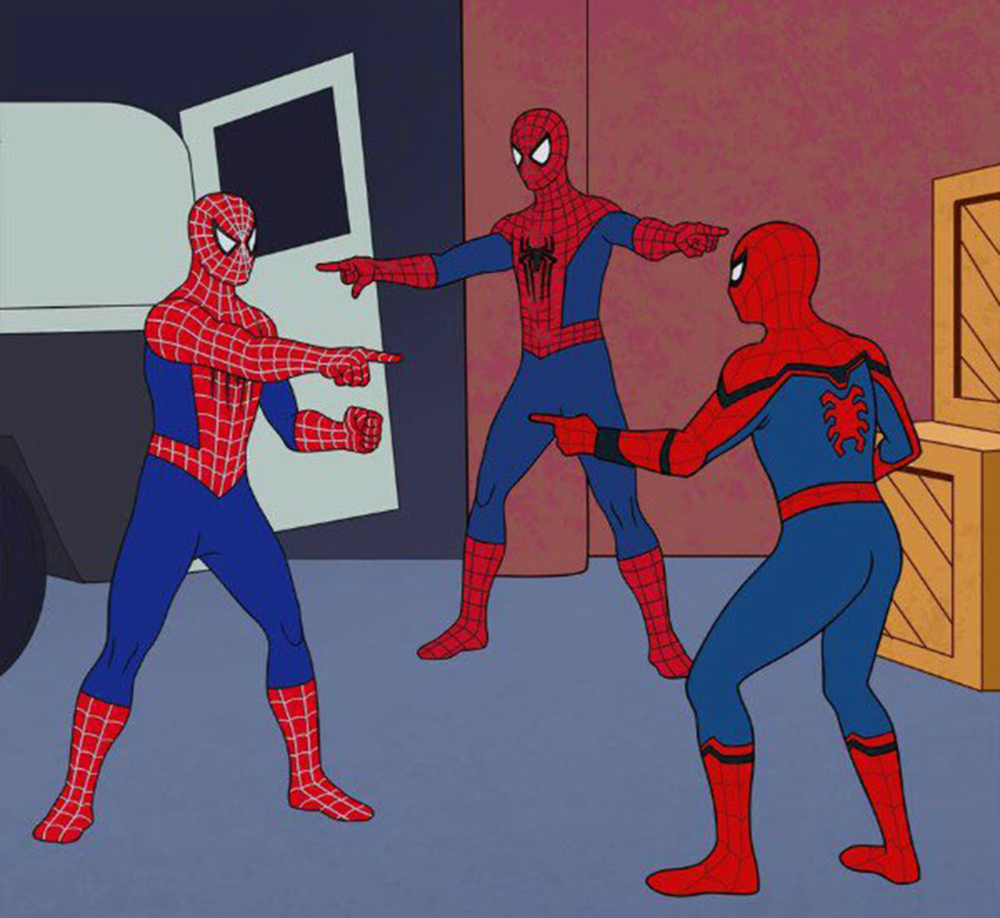

---

#### Create Pipline
here we will create a pipline that contain the main component that we will update its parameters later in the trails

In [34]:
# now I'm going to create a Common pipline also and I will change its parameters using the gridsearch, randomsearch and bayessearch as a hyperparameter
def createPipeline(model):
    
    transformer_numeric = Pipeline(
        steps = [
            ('imputer', SimpleImputer(strategy = 'median')),
            ('scaler', StandardScaler())
        ]
    )

    transformer_categorical = Pipeline(
        steps = [
            ('imputer', SimpleImputer(strategy = 'constant')),
            ('encoder', OneHotEncoder(handle_unknown = 'ignore'))
        ]
    )

    preprocessor = ColumnTransformer(
        transformers = [
            ('numeric', transformer_numeric, features_numeric),
            ('categorical', transformer_categorical, features_categorical)
        ]
    )
    
    full_pipline = Pipeline(
        steps = [
            ('preprocessor', preprocessor),
            ('sampling', None),
            ('kbest', None),
            ('classifier', model)
        ]
    )

    return full_pipline

---

---

### 1. RandomForestClassifier Trails

#### - Common Parameters
common parameters for random search that I think it is the best after I tried many of them

In [35]:
# hyperparameter for RandomForestClassifier
parameters = {
    'preprocessor__numeric__imputer__strategy': ['mean', 'median'],
    'preprocessor__categorical__imputer__strategy': ['constant', 'most_frequent'],
    'classifier__n_estimators': [50, 70],
    'classifier__max_depth': [10, 15],
    'classifier__criterion': ['entropy'],
    'classifier__class_weight': ['balanced'],
    'kbest': [None, SelectKBest()],
    'sampling': [None, SMOTE(random_state=seed)],
}

classifier_name = 'RandomForestClassifier'

#### 1. Grid Search trial

In [36]:
# grid search for RandomForestClassifier
full_pipline = createPipeline(RandomForestClassifier())
gs_rf_model = gridSearch(full_pipline, parameters)

Fitting 5 folds for each of 64 candidates, totalling 320 fits


In [37]:
# calculate the score for grid search
score(gs_rf_model, classifier_name)

Best Score 0.8560153595108005
Best Parameters {'classifier__class_weight': 'balanced', 'classifier__criterion': 'entropy', 'classifier__max_depth': 10, 'classifier__n_estimators': 70, 'kbest': SelectKBest(), 'preprocessor__categorical__imputer__strategy': 'most_frequent', 'preprocessor__numeric__imputer__strategy': 'mean', 'sampling': SMOTE(random_state=72)}
ROC AUC of the Model 0.9415274494914384
Done saving score for GridSearchCV


As we see the roc_auc was not bad when we used the random forest with grid search

lets try the random search with the same setup and see what will happen.

---

#### 2. Random Search trial

In [38]:
# random search for RandomForestClassifier
full_pipline = createPipeline(RandomForestClassifier())
rs_rf_model = randomSearch(full_pipline, parameters)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


In [39]:
# calculate the score for random search
score(rs_rf_model, classifier_name)

Best Score 0.8540262294275592
Best Parameters {'sampling': SMOTE(random_state=72), 'preprocessor__numeric__imputer__strategy': 'mean', 'preprocessor__categorical__imputer__strategy': 'constant', 'kbest': SelectKBest(), 'classifier__n_estimators': 50, 'classifier__max_depth': 10, 'classifier__criterion': 'entropy', 'classifier__class_weight': 'balanced'}
ROC AUC of the Model 0.9404978210379873
Done saving score for RandomizedSearchCV


As we see the roc_auc increased when we used the random search which is something awesome. 

lets try the bayesian search with the same setup and see what will happen.

---

#### 3. Bayesian Search trial

In [41]:
# bayes search for RandomForestClassifier
full_pipline = createPipeline(RandomForestClassifier())
rs_bs_model = bayesSearch(full_pipline, parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits


In [42]:
# calculate the score for bayes search
score(rs_bs_model, classifier_name)

Best Score 0.8557624124224293
Best Parameters OrderedDict([('classifier__class_weight', 'balanced'), ('classifier__criterion', 'entropy'), ('classifier__max_depth', 11), ('classifier__n_estimators', 65), ('kbest', SelectKBest()), ('preprocessor__categorical__imputer__strategy', 'most_frequent'), ('preprocessor__numeric__imputer__strategy', 'median'), ('sampling', SMOTE(random_state=72))])
ROC AUC of the Model 0.9549422371444531
Done saving score for BayesSearchCV


As we see the roc_auc almost still the smae as the random search where we use the same iteration number maybe that is a reason for that.

lets try changing the model itself and see what will happen.

---

---

### LogisticRegression

#### - Common Parameters
common parameters for Logitic regression that I think it is the best after I tried many of them

In [43]:
parameters = {
    'preprocessor__numeric__imputer__strategy': ['mean', 'median'],
    'preprocessor__categorical__imputer__strategy': ['constant', 'most_frequent'],
    'classifier__penalty': ['l2'],
    'classifier__C': [1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3],
    'classifier__solver': ['liblinear'],
    'classifier__class_weight': ['balanced'],
    'kbest': [SelectKBest()],
    'sampling': [SMOTE(random_state=seed)],
}

classifier_name = 'LogisticRegression'

#### 1. Grid Search trial

In [44]:
# grid search for LogisticRegression
full_pipline = createPipeline(LogisticRegression())
gs_lr_model = gridSearch(full_pipline, parameters)

Fitting 5 folds for each of 28 candidates, totalling 140 fits


In [45]:
# calculate the score for grid search
score(gs_lr_model, classifier_name)

Best Score 0.8480795713675079
Best Parameters {'classifier__C': 0.01, 'classifier__class_weight': 'balanced', 'classifier__penalty': 'l2', 'classifier__solver': 'liblinear', 'kbest': SelectKBest(), 'preprocessor__categorical__imputer__strategy': 'constant', 'preprocessor__numeric__imputer__strategy': 'mean', 'sampling': SMOTE(random_state=72)}
ROC AUC of the Model 0.8503232654894705
Done saving score for GridSearchCV


As we see the roc_auc was not bad it is lower like the one above with the gridsearch but with a different model,

lets try the random search with the same setup and see what will happen.

---

#### 2. Random Search trail

In [46]:
# random search for LogisticRegression
full_pipline = createPipeline(LogisticRegression())
rs_lr_model = randomSearch(full_pipline, parameters)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


In [47]:
# calculate the score for random search
score(rs_lr_model, classifier_name)

Best Score 0.8479733002582712
Best Parameters {'sampling': SMOTE(random_state=72), 'preprocessor__numeric__imputer__strategy': 'median', 'preprocessor__categorical__imputer__strategy': 'constant', 'kbest': SelectKBest(), 'classifier__solver': 'liblinear', 'classifier__penalty': 'l2', 'classifier__class_weight': 'balanced', 'classifier__C': 0.01}
ROC AUC of the Model 0.8502615618266587
Done saving score for RandomizedSearchCV


As we see the roc_auc almost didn't change with the random search.

lets try the bayesian search with the same setup and see what will happen.

---

#### 3. Bayesian Search trial

In [48]:
# bayes search for LogisticRegression
full_pipline = createPipeline(LogisticRegression())
bs_lr_model = bayesSearch(full_pipline, parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits


In [49]:
# calculate the score for bayes search
score(bs_lr_model, classifier_name)

Best Score 0.8480795713675079
Best Parameters OrderedDict([('classifier__C', 0.01), ('classifier__class_weight', 'balanced'), ('classifier__penalty', 'l2'), ('classifier__solver', 'liblinear'), ('kbest', SelectKBest()), ('preprocessor__categorical__imputer__strategy', 'constant'), ('preprocessor__numeric__imputer__strategy', 'mean'), ('sampling', SMOTE(random_state=72))])
ROC AUC of the Model 0.8503232654894705
Done saving score for BayesSearchCV


As we see the roc_auc still the same again on the bayesian search so the three different methods didn't affect the roc_auc.

lets try changing the model again and see what will happen.

Maybe the hope is in this model 😂

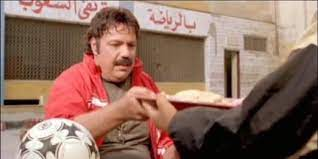

---

---

### XGBoost

#### - Common Parameters
common parameters for XGBoost that I think it is the best after I tried many of them

In [50]:
parameters = {
    'preprocessor__numeric__imputer__strategy': ['mean', 'median'],
    'preprocessor__categorical__imputer__strategy': ['constant', 'most_frequent'],
    'classifier__learning_rate': [0.02],
    'classifier__max_depth': [10, 11, 12],
    'classifier__n_estimators': [500],
    'classifier__subsample': [0.8],                                                
    'classifier__reg_alpha': [0.3],
    'classifier__reg_lambda': [0.1],
    'classifier__gamma': [0.0],
    'kbest': [SelectKBest()],
    'sampling': [SMOTE(random_state=seed)],
}

classifier_name = 'XGBoost'

#### 1. Grid Search trial

In [51]:
# grid search for XGBoost
full_pipline = createPipeline(XGBClassifier())
gs_xg_model = gridSearch(full_pipline, parameters)

Fitting 5 folds for each of 12 candidates, totalling 60 fits


In [52]:
# calculate the score for grid search
score(gs_xg_model, classifier_name)

Best Score 0.8456752703203347
Best Parameters {'classifier__gamma': 0.0, 'classifier__learning_rate': 0.02, 'classifier__max_depth': 10, 'classifier__n_estimators': 500, 'classifier__reg_alpha': 0.3, 'classifier__reg_lambda': 0.1, 'classifier__subsample': 0.8, 'kbest': SelectKBest(), 'preprocessor__categorical__imputer__strategy': 'constant', 'preprocessor__numeric__imputer__strategy': 'mean', 'sampling': SMOTE(random_state=72)}
ROC AUC of the Model 0.9989420907010934
Done saving score for GridSearchCV


As we see the roc_auc was not bad it is lower like the above 2 models with the gridsearch,

lets try the random search with the same setup and see what will happen.

---

#### 2. Random Search trial

In [53]:
# random search for XGBoost
full_pipline = createPipeline(XGBClassifier())
rs_xg_model = randomSearch(full_pipline, parameters)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


In [54]:
# calculate the score for random search
score(rs_xg_model, classifier_name)

Best Score 0.8456752703203347
Best Parameters {'sampling': SMOTE(random_state=72), 'preprocessor__numeric__imputer__strategy': 'mean', 'preprocessor__categorical__imputer__strategy': 'constant', 'kbest': SelectKBest(), 'classifier__subsample': 0.8, 'classifier__reg_lambda': 0.1, 'classifier__reg_alpha': 0.3, 'classifier__n_estimators': 500, 'classifier__max_depth': 10, 'classifier__learning_rate': 0.02, 'classifier__gamma': 0.0}
ROC AUC of the Model 0.9989420907010934
Done saving score for RandomizedSearchCV


As we see the roc_auc is exactly the same as the gridsearch,

lets try the bayesian search with the same setup and see what will happen.

---

#### 3. Bayesian Search trial

In [55]:
# bayes search for XGBoost
full_pipline = createPipeline(XGBClassifier())
bs_xg_model = bayesSearch(full_pipline, parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits


In [56]:
# calculate the score for bayes search
score(bs_xg_model, classifier_name)

Best Score 0.8456752703203347
Best Parameters OrderedDict([('classifier__gamma', 0.0), ('classifier__learning_rate', 0.02), ('classifier__max_depth', 10), ('classifier__n_estimators', 500), ('classifier__reg_alpha', 0.3), ('classifier__reg_lambda', 0.1), ('classifier__subsample', 0.8), ('kbest', SelectKBest()), ('preprocessor__categorical__imputer__strategy', 'constant'), ('preprocessor__numeric__imputer__strategy', 'mean'), ('sampling', SMOTE(random_state=72))])
ROC AUC of the Model 0.9989420907010934
Done saving score for BayesSearchCV


As we see the roc_auc is exactly the same as the gridsearch and random search, maybe because the number of iterations is near to the read number of hyperparameter combinations.

lets try another model and see what will happen.

---

---

### SVM

#### - Common Parameters

In [57]:
parameters = {
    'preprocessor__numeric__imputer__strategy': ['mean', 'median'],
    'preprocessor__categorical__imputer__strategy': ['constant', 'most_frequent'],
    'classifier__C': [1e-1, 1, 1e1],
    'kbest': [SelectKBest()],
    'sampling': [SMOTE(random_state=seed)],
}

classifier_name = 'SVM'

#### 1. Grid Search trail

In [58]:
# grid search for SVM
full_pipline = createPipeline(SVC(probability=True))
gs_svm_model = gridSearch(full_pipline, parameters)

Fitting 5 folds for each of 12 candidates, totalling 60 fits


In [59]:
# calculate the score for grid search
score(gs_svm_model, classifier_name)

Best Score 0.8414902727859742
Best Parameters {'classifier__C': 0.1, 'kbest': SelectKBest(), 'preprocessor__categorical__imputer__strategy': 'constant', 'preprocessor__numeric__imputer__strategy': 'mean', 'sampling': SMOTE(random_state=72)}
ROC AUC of the Model 0.8591724962916097
Done saving score for GridSearchCV


As we see there is no imporvment over the roc_auc from the above 3 models with the gridsearch,

lets try the random search with the same setup and see what will happen.

---

#### 2. Random Search trail

In [60]:
# random search for SVM
full_pipline = createPipeline(SVC(probability=True))
rs_svm_model = randomSearch(full_pipline, parameters)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


In [61]:
# calculate the score for random search
score(rs_svm_model, classifier_name)

Best Score 0.8414902727859742
Best Parameters {'sampling': SMOTE(random_state=72), 'preprocessor__numeric__imputer__strategy': 'mean', 'preprocessor__categorical__imputer__strategy': 'constant', 'kbest': SelectKBest(), 'classifier__C': 0.1}
ROC AUC of the Model 0.8591741417226182
Done saving score for RandomizedSearchCV


As we see the roc_auc is exactly the same as the gridsearch,

lets try the bayesian search with the same setup and see what will happen.

---

#### 3. Bayesian Search trail

In [62]:
# bayes search for SVM
full_pipline = createPipeline(SVC(probability=True))
bs_svm_model = bayesSearch(full_pipline, parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits


In [63]:
# calculate the score for bayes search
score(bs_svm_model, classifier_name)

Best Score 0.840903458305488
Best Parameters OrderedDict([('classifier__C', 0.1), ('kbest', SelectKBest()), ('preprocessor__categorical__imputer__strategy', 'constant'), ('preprocessor__numeric__imputer__strategy', 'median'), ('sampling', SMOTE(random_state=72))])
ROC AUC of the Model 0.858351117700148
Done saving score for BayesSearchCV


As we see the roc_auc slightly reduced on the bayesian search.

lets try changing the model again and see what will happen.

---

---

### K-NearestNeighbors

#### - Common Parameters

In [64]:
parameters = {
    'classifier__n_neighbors':list(range(20, 50)),
    'kbest': [SelectKBest()],
    'sampling': [SMOTE(random_state=seed)],
}

classifier_name = 'K-NearestNeighbors'

#### 1. Grid Search trail

In [65]:
# grid search for K-NearestNeighbors
full_pipline = createPipeline(KNeighborsClassifier())
gs_knn_model = gridSearch(full_pipline, parameters)

Fitting 5 folds for each of 30 candidates, totalling 150 fits


In [67]:
# calculate the score for grid search
score(gs_knn_model, classifier_name)

Best Score 0.8512871365678665
Best Parameters {'classifier__n_neighbors': 47, 'kbest': SelectKBest(), 'sampling': SMOTE(random_state=72)}
ROC AUC of the Model 0.8815399712214117
Done saving score for GridSearchCV


As we see the roc_auc was not bad with the gridsearch,

lets try the random search with the same setup and see what will happen.

---

#### 2. Random Search trail 

In [68]:
# random search for K-NearestNeighbors
full_pipline = createPipeline(KNeighborsClassifier())
rs_knn_model = randomSearch(full_pipline, parameters)

Fitting 5 folds for each of 10 candidates, totalling 50 fits


In [69]:
# calculate the score for random search
score(rs_knn_model, classifier_name)

Best Score 0.8512871365678665
Best Parameters {'sampling': SMOTE(random_state=72), 'kbest': SelectKBest(), 'classifier__n_neighbors': 47}
ROC AUC of the Model 0.8815399712214117
Done saving score for RandomizedSearchCV


As we see the roc_auc is exactly the same as the gridsearch,

lets try the bayesian search with the same setup and see what will happen.

---

#### 3. Bayesian Search trail

In [70]:
# bayes search for K-NearestNeighbors
full_pipline = createPipeline(KNeighborsClassifier())
bs_knn_model = bayesSearch(full_pipline, parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits
Fitting 5 folds for each of 1 candidates, totalling 5 fits


In [71]:
# calculate the score for bayes search
score(bs_knn_model, classifier_name)

Best Score 0.8509952603711453
Best Parameters OrderedDict([('classifier__n_neighbors', 46), ('kbest', SelectKBest()), ('sampling', SMOTE(random_state=72))])
ROC AUC of the Model 0.8818724511245287
Done saving score for BayesSearchCV


As we see the roc_auc is almost the same as the random search and gridsearch,

---

---

### Conclusion

From the above trails we can see that the roc_auc is trapped between 84% and 86% which is not bad.

After many and many trails and asking collegues and searching the web:
I fid that XGBoost is the best for this task.
which I submitted on kaggle and get the #13 rank

I used different classifiers in this notebook:
- RandomForestClassifier
- LogisticRegression
- XGBoost
- SVM
- K-NearestNeighbors

I used also different Preprocessing Techniques:
- SimpleImputer -> for missing values
    - Mean
    - Median
    - Constant
    - most_frequent
- OneHotEncoder -> for category features
- SMOTE -> for data imbalance
- SelectKBest -> for selecting the best features

Finally I used GridSearch, RandomSearch and BayesianSearch with preprocessing pipline and lots of different hyperparameters 